In [1]:
import numpy as np
from scipy.cluster import hierarchy
from scipy.spatial import distance
import pandas as pd
import string

letters = list(string.ascii_lowercase)

np.random.seed(1)
data = np.random.multivariate_normal([0,0],[[5, 0], [0, 1]], 26)

df = pd.DataFrame(data, columns=["x","y"])
df["labels"] = letters

X = distance.pdist(data)
Z = hierarchy.linkage(X)
P = hierarchy.dendrogram(Z, labels=letters, no_plot=True)

clusters = letters.copy()

print("------Z:")
for c1, c2, _, _ in Z:
    clusters.append(clusters[int(c1)]+clusters[int(c2)])
    print(clusters[-1])

def lookup(y, x):
    return "?" if y else P["ivl"][int((x-5)/10)]

print("\n------P:")
for ((x1,x2,x3,x4),(y1,y2,y3,y4)) in zip(P["icoord"], P["dcoord"]):
     print(lookup(y1, x1)+lookup(y4, x4))

------Z:
iu
ez
niu
jy
ad
pr
bq
prbq
wniu
gwniu
ezgwniu
hm
ojy
prbqezgwniu
ks
ojyprbqezgwniu
vks
ojyprbqezgwniuvks
lhm
adlhm
fadlhm
cfadlhm
tcfadlhm
ojyprbqezgwniuvkstcfadlhm
xojyprbqezgwniuvkstcfadlhm

------P:
jy
o?
pr
bq
??
ez
iu
n?
w?
g?
??
??
??
ks
v?
??
ad
hm
l?
??
f?
c?
t?
??
x?


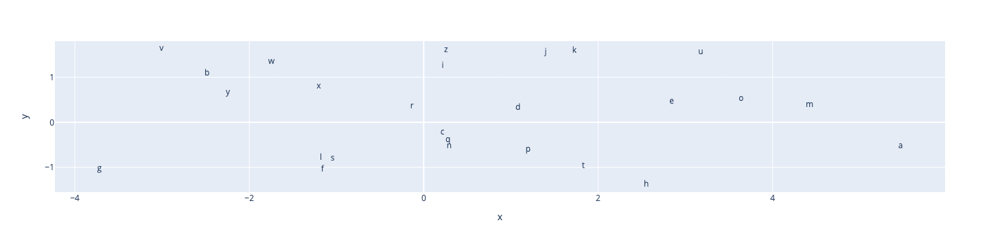

In [249]:
import plotly.express as px
px.scatter(df, x="x", y="y", text="labels").update_traces(mode="text")

In [208]:
ncd_df["cd"] = ncd_df["ab"] - ncd_df[['a','b']].min(axis=1)

In [204]:
ncd_df = pd.read_csv(f"results/ncd_costs.csv", names=["gallery", "notation", "from_spec", "to_spec", "a", "b", "ab"])
ncd_df["cd"] = ncd_df.apply(lambda row: row["ab"] - min(row["a"], row["b"]), axis=1)
ncd_df["ncd"] = ncd_df.apply(lambda row: row["cd"] / max(row["a"], row["b"]), axis=1)


In [63]:
import networkx as nx

In [73]:
import plotly.express as px

In [69]:
import numpy as np
A = np.array([[1, 1], [2, 1]])
G = nx.from_numpy_matrix(dmat_sym)

In [71]:
pos = nx.kamada_kawai_layout(G)

In [86]:
import igraph

In [131]:
dmat_sym

array([[  0. , 302. , 298. , ..., 331.5, 314.5, 326. ],
       [302. ,   0. ,  22. , ..., 109. ,  69. , 105.5],
       [298. ,  22. ,   0. , ..., 113. ,  68.5, 114. ],
       ...,
       [331.5, 109. , 113. , ...,   0. ,  97. , 131.5],
       [314.5,  69. ,  68.5, ...,  97. ,   0. ,  84. ],
       [326. , 105.5, 114. , ..., 131.5,  84. ,   0. ]])

In [78]:
from scipy.sparse.csgraph import minimum_spanning_tree
from scipy.sparse import coo_matrix
spanning = coo_matrix(minimum_spanning_tree(dmat_sym))

In [144]:
mst

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

In [198]:
mst = minimum_spanning_tree(dmat_sym).toarray()
mst = 1./mst
mst= np.nan_to_num(mst, posinf=0)
g = igraph.Graph.Weighted_Adjacency(mst.tolist())

layout= g.layout_fruchterman_reingold(weights="weight", niter=10_000)
coords = np.array(layout.coords).T

/var/folders/20/zn579xsd7m3fm3yxbg9kkj640000gp/T/ipykernel_32966/4033934040.py:2: RuntimeWarning:

divide by zero encountered in true_divide



In [190]:
#g = igraph.Graph.Weighted_Adjacency(spanning.toarray().tolist())
#np.random.seed(123)
#layout = g.layout_fruchterman_reingold(niter=100000)
#coords = np.array(layout.coords).T

In [199]:
fig = px.scatter(x=coords[0], y=coords[1], height=800, hover_name=order)

In [200]:
x = []
y = []
for i,j in zip(spanning.row, spanning.col):
    x += [coords[0][i], coords[0][j], None]
    y += [coords[1][i], coords[1][j], None]
fig.add_scatter(x=x,y=y, showlegend=False, line_color="lightgrey", line_width=2)
fig.data = tuple(reversed(fig.data))

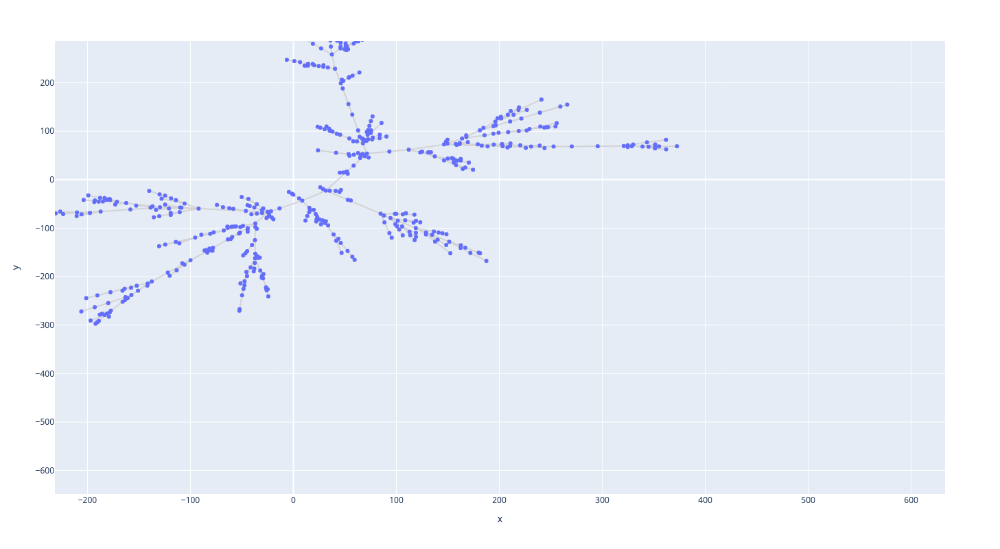

In [201]:
fig.show(config=dict(scrollZoom=True))

In [32]:
import pandas as pd
import numpy as np

In [27]:
difflib_df = pd.read_csv(f"results/difflib_costs.csv", names=["gallery", "system", "from_spec", "to_spec", "cost"])
ncd_df = pd.read_csv(f"results/difflib_costs.csv", names=["gallery", "system", "from_spec", "to_spec", "cost2"])


In [42]:
square = ncd_df.query("gallery == 'vega-lite'").pivot_table(index="from_spec", columns="to_spec", values="cost2").fillna(0)


In [43]:
dmat_sym = (square.values+square.values.T)/2.

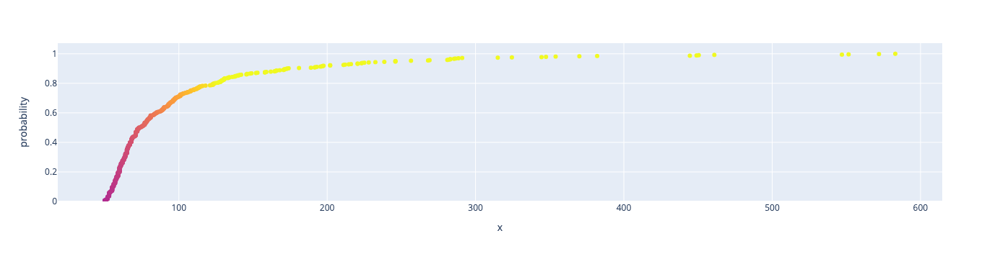

In [60]:
import plotly.express as px

x=np.median(dmat_sym, axis=0)
fig = px.ecdf(x=x, markers=True, lines=False)
fig.data[0].marker.color = fig.data[0].x
fig.data[0].marker.cmin=0
fig.data[0].marker.cmax=np.mean(dmat_sym)
fig

In [61]:
from umap import UMAP

In [10]:
pd.merge(difflib_df, ncd_df, how="outer")

,gallery,system,from_spec,to_spec,cost,cost2
0,autogen,plotly_express,scatter_time_time_tip,scatter_tip_tip_time,3,3
1,autogen,plotly_express,scatter_time_time_tip,bar_time_tip_time,3,3
2,autogen,plotly_express,scatter_time_time_tip,scatter_tip_time_time,2,2
3,autogen,plotly_express,scatter_time_time_tip,line_time_time_time,2,2
4,autogen,plotly_express,scatter_time_time_tip,line_time_time_tip,1,1
...,...,...,...,...,...,...
280593,vega-lite,vega-lite,selection_layer,interactive_paintbrush.vl,171,171
280594,vega-lite,vega-lite,selection_layer,bar_tooltip_multi.vl,249,249
280595,vega-lite,vega-lite,selection_layer,geo_graticule_object.vl,269,269
280596,vega-lite,vega-lite,selection_layer,joinaggregate_percent_of_total.vl,266,266


In [104]:
int(1000*0.012)

12

In [79]:
np.max(square.values)

3933.0

In [83]:
from scipy.spatial.distance import squareform

In [17]:
import plotly.express as px

array([  0., 419., 344., ..., 432., 413.,   0.])

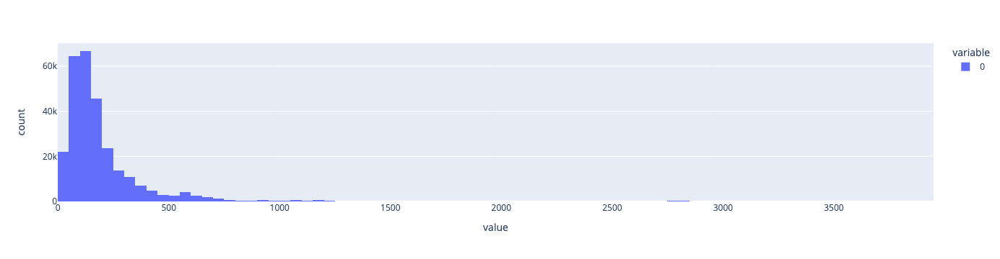

In [23]:
px.histogram(np.ravel(square.values), nbins=100)

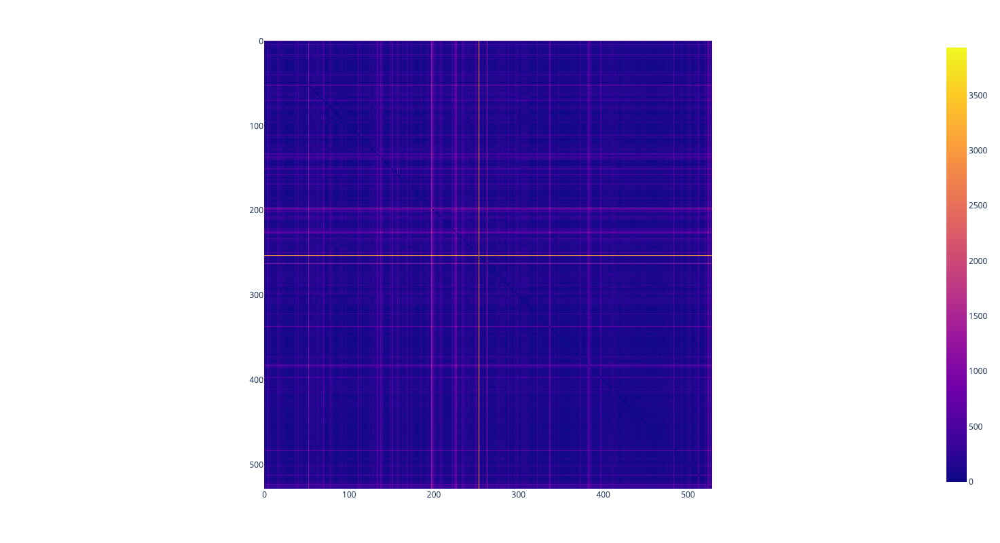

In [19]:
px.imshow(square.values, height=800)

In [88]:
square.values + square.values.T

array([[   0.,  820.,  717., ..., 1278., 1202.,  775.],
       [ 820.,    0.,  176., ...,  626.,  547.,  296.],
       [ 717.,  176.,    0., ...,  691.,  599.,  238.],
       ...,
       [1278.,  626.,  691., ...,    0.,  721.,  790.],
       [1202.,  547.,  599., ...,  721.,    0.,  714.],
       [ 775.,  296.,  238., ...,  790.,  714.,    0.]])

In [1]:
import numpy as np
import pandas as pd
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform
from pyminimax import minimax
import plotly.graph_objects as go

ncd_df = pd.read_csv("results/vega-lite/vega-lite/ncd_costs.csv", names=["gallery", "notation", "from_spec", "to_spec", "a", "b", "ab"])
ncd_df["cd"] = ncd_df["ab"] - ncd_df[["a", "b"]].min(axis=1)
ncd_df["ncd"] = (1000 * ncd_df["cd"] / ncd_df[["a", "b"]].max(axis=1))
square = ncd_df.pivot_table(index="from_spec", columns="to_spec", values="ncd").fillna(0)
order = list(square.index)

#Z = minimax(squareform((square.values + square.values.T)/2.0))

In [2]:
X = (square.values + square.values.T)/2.0

In [3]:
def check(X):
    for i in range(len(X)):
        for j in range(len(X)):
            for k in range(len(X)):
                if X[i,j] > X[i,k]+X[k,j]:
                    return i,j,k,order[i],order[j],order[k],X[i,j],X[i,k],X[k,j]
    return True

check(square.values)

(20,
 331,
 316,
 'area_vertical.vl',
 'line_step.vl',
 'line_monotone.vl',
 357.14285714285717,
 314.2857142857143,
 42.857142857142854)

In [4]:
%%time
Z = minimax(squareform(X))


TypingError: Failed in nopython mode pipeline (step: nopython frontend)
[1m[1mNo implementation of function Function(<built-in function setitem>) found for signature:
 
 >>> setitem(array(int32, 0d, C), Literal[int](0), int64)
 
There are 16 candidate implementations:
[1m      - Of which 14 did not match due to:
      Overload of function 'setitem': File: <numerous>: Line N/A.
        With argument(s): '(array(int32, 0d, C), int64, int64)':[0m
[1m       No match.[0m
[1m      - Of which 1 did not match due to:
      Overload in function 'SetItemBuffer.generic': File: numba/core/typing/arraydecl.py: Line 176.
        With argument(s): '(array(int32, 0d, C), int64, int64)':[0m
[1m       Rejected as the implementation raised a specific error:
         NumbaTypeError: [1mcannot index array(int32, 0d, C) with 1 indices: [int64][0m[0m
  raised from /Users/nicolas/opt/miniconda3/envs/env/lib/python3.9/site-packages/numba/core/typing/arraydecl.py:88
[1m      - Of which 1 did not match due to:
      Overload in function 'SetItemBuffer.generic': File: numba/core/typing/arraydecl.py: Line 176.
        With argument(s): '(array(int32, 0d, C), Literal[int](0), int64)':[0m
[1m       Rejected as the implementation raised a specific error:
         NumbaTypeError: [1mcannot index array(int32, 0d, C) with 1 indices: [Literal[int](0)][0m[0m
  raised from /Users/nicolas/opt/miniconda3/envs/env/lib/python3.9/site-packages/numba/core/typing/arraydecl.py:88
[0m
[0m[1mDuring: typing of staticsetitem at /Users/nicolas/ets/notascope/pyminimax/_minimax.py (117)[0m
[1m
File "pyminimax/_minimax.py", line 117:[0m
[1m#     cdef double dist, current_min
    <source elided>
                if size[i] > 0:
[1m                    cluster_chain[0] = i
[0m                    [1m^[0m[0m


In [31]:
%%time
Z = hierarchy.optimal_leaf_ordering(Z, squareform((square.values + square.values.T)/2.0))

CPU times: user 88.6 ms, sys: 5.64 ms, total: 94.2 ms
Wall time: 91.8 ms


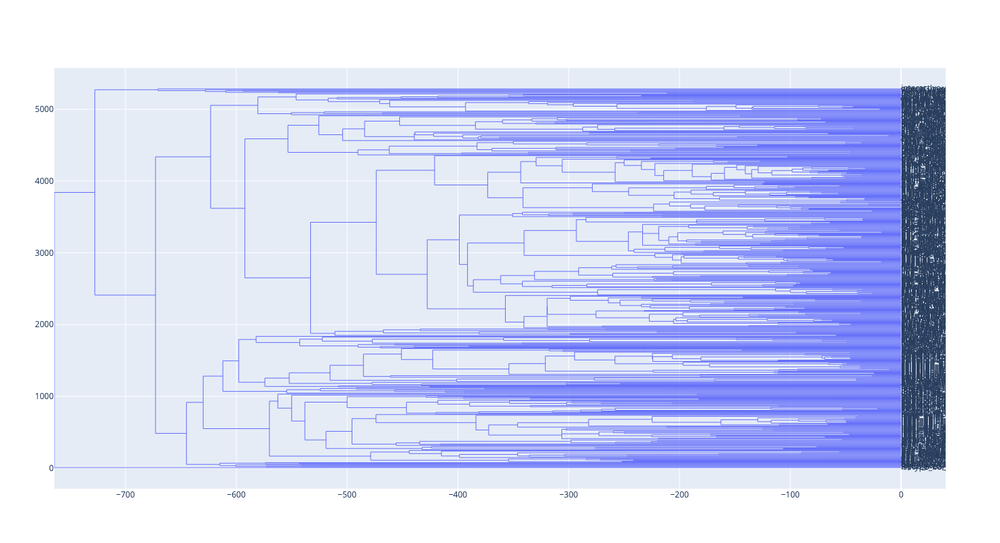

In [32]:
P = hierarchy.dendrogram(Z, labels=order, no_plot=True, get_leaves=True)

x=[]
y=[]
label_x=[]
label_y=[]
label_text=[]
for icoord, dcoord in zip(P["icoord"], P["dcoord"]):
    for i, d in zip(icoord, dcoord):
        y.append(i)
        x.append(-d)
        if d == 0:
            label_x.append(-d)
            label_y.append(i)
            label_text.append(P["ivl"][int((i-5)/10)])
    y.append(None)
    x.append(None)
fig = go.Figure()
fig.add_scatter(x=x, y=y, line_width=1, hoverinfo="none")
fig.add_scatter(x=label_x, y=label_y, text=label_text, mode="text", textposition="middle right")
fig.update_layout(height=800, showlegend=False)

In [20]:


def append_members(nodes, node):
    if len(nodes[node]) == 3:
        return nodes[node][2]
    nodes[node].append([])
    for child in nodes[node][:2]:
        if type(child) is int:
            nodes[node][2].append(child)
        else:
            nodes[node][2]+=append_members(nodes, child)
    return nodes[node][2]

def make_nodes(P):
    nodes = dict()
    for xs, ys in zip(P["dcoord"], P["icoord"]):
        x_mid = ((xs[1]+xs[2])/2)
        y_mid = ((ys[1]+ys[2])/2)
        node = (x_mid, y_mid)
        nodes[node] = []
        for i in [0,3]:
            if xs[i] == 0:
                nodes[node].append(order.index(P["ivl"][int((ys[i] - 5) / 10)]))
            else:
                nodes[node].append((xs[i],ys[i]))
    for n in nodes:
        append_members(nodes, n)
    return nodes

In [21]:
def append_members(nodes, node):
    if len(nodes[node]) == 3:
        return nodes[node][2]
    nodes[node].append([])
    for child in nodes[node][:2]:
        if type(child) is int:
            nodes[node][2].append(child)
        else:
            nodes[node][2]+=append_members(nodes, child)
    return nodes[node][2]
        

In [22]:
list(range(5))[:2]

[0, 1]

In [25]:
nodes, root = make_nodes(P)

524

In [12]:
nodes[root]

[253,
 (1110.5, 25.000000922231067),
 [253,
  197,
  263,
  52,
  227,
  225,
  199,
  483,
  523,
  157,
  137,
  337,
  250,
  383,
  524,
  226,
  151,
  4,
  0,
  70,
  382,
  222,
  16,
  526,
  512,
  513,
  521,
  198,
  40,
  254,
  133,
  134,
  208,
  233,
  411,
  527,
  201,
  111,
  385,
  397,
  114,
  168,
  384,
  207,
  139,
  132,
  196,
  209,
  322,
  235,
  169,
  224,
  373,
  148,
  149,
  282,
  173,
  499,
  186,
  299,
  414,
  502,
  291,
  18,
  492,
  21,
  481,
  348,
  298,
  519,
  138,
  136,
  210,
  402,
  381,
  296,
  184,
  248,
  78,
  249,
  192,
  6,
  336,
  154,
  295,
  287,
  288,
  464,
  262,
  245,
  38,
  189,
  163,
  297,
  124,
  45,
  221,
  239,
  43,
  39,
  64,
  234,
  236,
  60,
  61,
  59,
  57,
  63,
  62,
  67,
  97,
  68,
  488,
  56,
  364,
  283,
  200,
  194,
  170,
  386,
  528,
  375,
  525,
  7,
  130,
  131,
  37,
  475,
  135,
  53,
  260,
  277,
  275,
  276,
  125,
  289,
  193,
  202,
  203,
  8,
  211,
  371,
  3

In [ ]:
append_members

In [150]:
[order[i] for i in P["leaves"][-10:]][::-1]

['test_single_point_color.vl',
 'test_minimal',
 'stacked_area.vl',
 'area.vl',
 'boxplot_1D_vertical.vl',
 'boxplot_1D_horizontal.vl',
 'boxplot_1D_horizontal_explicit.vl',
 'boxplot_1D_horizontal_custom_mark.vl',
 'boxplot_minmax_2D_horizontal.vl',
 'boxplot_2D_horizontal.vl']

In [48]:
from functools import cache

In [88]:
def examples_in_leaf(Z, i, j):
    n = len(Z)+1
    c = int(Z[i][j])
    if c < n:
        return [c]
    return examples_in_leaf(Z, c-n, 0) + examples_in_leaf(Z, c-n, 1)

In [90]:
examples_in_leaf(Z, 200, 0)

[441]

In [122]:
def medioid(samples, dmat_sym):
    subset = dmat_sym[samples][:, samples]
    sum_dist = np.sum(subset, axis=0)
    return samples[np.argsort(sum_dist)[0]]

In [133]:
examples_in_leaf(Z,6,1)

[412, 433]

In [134]:
medioid( examples_in_leaf(Z,6,1),  ((square.values + square.values.T) /2.0) )

412

In [139]:
len(P["icoord"])

528

In [128]:
np.array(Z).astype(int)[:20]

array([[155, 156,   0,   2],
       [438, 448,   0,   2],
       [436, 446,   0,   2],
       [407, 410,   0,   2],
       [ 81, 230,   0,   2],
       [412, 433,   1,   2],
       [434, 534,   1,   3],
       [115, 451,   1,   2],
       [ 74, 314,   1,   2],
       [293, 332,   1,   2],
       [511, 514,   1,   2],
       [268, 272,   1,   2],
       [152, 153,   1,   2],
       [160, 541,   1,   3],
       [430, 431,   1,   2],
       [432, 543,   1,   3],
       [440, 442,   1,   2],
       [443, 444,   1,   2],
       [419, 421,   1,   2],
       [242, 281,   1,   2]])

In [78]:
for c1, c2, dist, num in np.array(Z).astype(int)[100:110]:
    print(len(examples_in_cluster(c1,c2)))

TypeError: object of type 'numpy.int64' has no len()

In [40]:
P["leaves"][:10]

[253, 197, 263, 52, 227, 225, 199, 483, 523, 157]

In [43]:
square.values[52][P["leaves"]]

array([3660., 2037., 1650.,    0., 1602., 1609., 1284., 1354., 1453.,
       1434., 1493., 1306., 1472., 1364., 1096., 1429., 1252., 1308.,
       1085., 1024., 1258., 1154., 1277., 1194., 1208., 1204., 1205.,
       1053., 1149., 1036.,  941.,  938., 1083., 1184., 1055., 1191.,
       1165.,  920., 1105., 1217., 1061., 1043.,  978.,  926., 1062.,
       1147., 1151., 1030., 1226., 1124., 1069., 1091., 1101., 1090.,
       1090., 1094., 1074., 1069., 1007., 1024.,  955., 1027.,  939.,
       1076.,  939.,  935., 1095., 1050., 1068.,  939., 1037.,  959.,
       1027., 1080., 1033.,  998.,  852.,  936., 1076.,  970., 1028.,
        884.,  938.,  868.,  969.,  963., 1004.,  963.,  934.,  963.,
        951.,  875.,  964.,  957., 1048.,  945., 1103.,  907.,  810.,
        985., 1106., 1105., 1095.,  909.,  907., 1074., 1088.,  896.,
        880., 1075.,  884.,  873.,  881.,  880.,  881.,  978.,  982.,
        932.,  976.,  969.,  927.,  955.,  960.,  906.,  882.,  866.,
       1084.,  930.,

In [33]:
len(square.values[1][P["ivl"]])

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [16]:
square.values[2][np.argsort(square.values[2])]

array([   0.,   14.,   15.,   16.,   16.,   17.,   19.,   19.,   20.,
         20.,   20.,   20.,   20.,   20.,   21.,   21.,   21.,   21.,
         22.,   22.,   23.,   24.,   24.,   24.,   25.,   25.,   26.,
         26.,   26.,   26.,   26.,   26.,   27.,   27.,   28.,   28.,
         28.,   28.,   28.,   28.,   28.,   29.,   29.,   29.,   30.,
         30.,   30.,   30.,   30.,   31.,   31.,   31.,   31.,   31.,
         32.,   32.,   32.,   34.,   34.,   34.,   34.,   34.,   34.,
         34.,   34.,   34.,   34.,   34.,   34.,   34.,   35.,   35.,
         35.,   35.,   36.,   36.,   37.,   37.,   37.,   38.,   38.,
         38.,   38.,   38.,   38.,   39.,   39.,   39.,   39.,   39.,
         39.,   39.,   39.,   39.,   40.,   40.,   40.,   40.,   41.,
         41.,   41.,   41.,   41.,   42.,   42.,   42.,   42.,   42.,
         42.,   42.,   42.,   43.,   43.,   44.,   44.,   44.,   44.,
         44.,   44.,   44.,   45.,   45.,   45.,   46.,   46.,   46.,
         46.,   46.,

In [49]:
np.array(Z).astype(int)[50:]

array([[   99,    75,    95,     2],
       [  204,   205,    95,     2],
       [  547,   293,    96,     3],
       ...,
       [ 1052,  1051, 15047,    15],
       [ 1054,  1053, 24720,   528],
       [  253,  1055, 62320,   529]])

In [55]:
(1302.6780128479004-54.375)/2 + 54.375

678.5265064239502

In [53]:
P["icoord"][-10:]

[[5260.0, 5260.0, 5280.0, 5280.0],
 [5190.625, 5190.625, 5270.0, 5270.0],
 [5089.6875, 5089.6875, 5230.3125, 5230.3125],
 [4867.265625, 4867.265625, 5160.0, 5160.0],
 [4201.940002441406, 4201.940002441406, 5013.6328125, 5013.6328125],
 [2378.2177734375, 2378.2177734375, 4607.786407470703, 4607.786407470703],
 [1067.0068359375, 1067.0068359375, 3493.0020904541016, 3493.0020904541016],
 [325.3515625, 325.3515625, 2280.004463195801, 2280.004463195801],
 [54.375, 54.375, 1302.6780128479004, 1302.6780128479004],
 [5.0, 5.0, 678.5265064239502, 678.5265064239502]]

In [ ]:
fig.show("json")

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


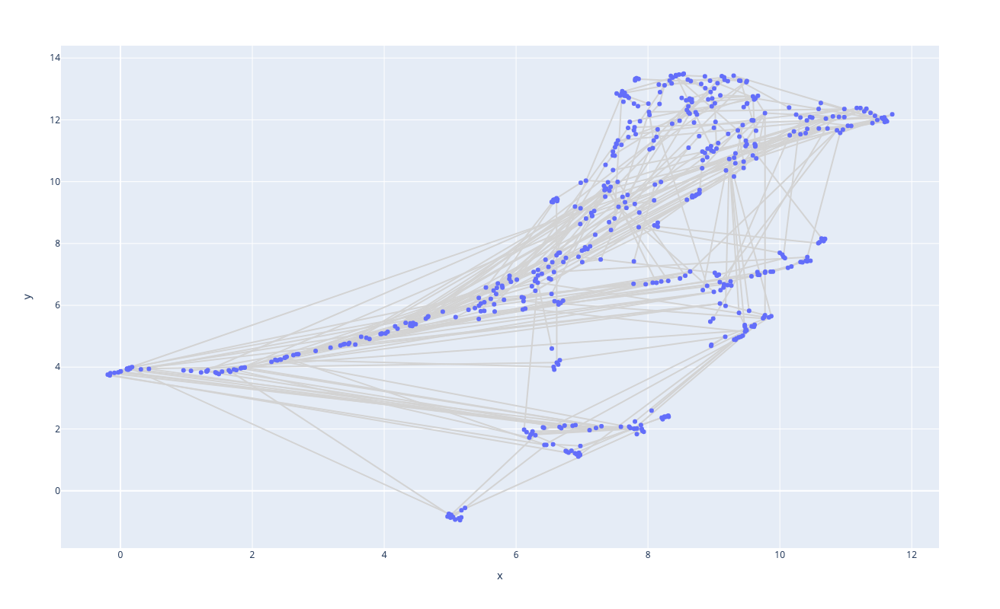

In [24]:
import pandas as pd

costs_df = pd.read_csv(
    f"results/vega-lite/vega-lite/difflib_costs.csv",
    names=["gallery", "system", "from_spec", "to_spec", "cost"],
)



square = costs_df.pivot_table(index="from_spec", columns="to_spec", values="cost").fillna(0)
order = list(square.index)


from sklearn.manifold import TSNE
from umap import UMAP


dimred = UMAP()# TSNE(n_components=2, metric="precomputed", n_iter=10000)
embedding = dimred.fit_transform(square.values)
emb_df = pd.DataFrame(embedding, index=order, columns=["x", "y"])


import plotly.express as px

fig = px.scatter(emb_df, x="x", y="y", hover_name=order, height=800, width=800)

from scipy.sparse.csgraph import minimum_spanning_tree
from scipy.sparse import coo_matrix


spanning = coo_matrix(minimum_spanning_tree(square))

x = []
y = []
for i,j in zip(spanning.row, spanning.col):
    x += [emb_df.loc[order[i]].x, emb_df.loc[order[j]].x, None]
    y += [emb_df.loc[order[i]].y, emb_df.loc[order[j]].y, None]
fig.add_scatter(x=x,y=y, showlegend=False, line_color="lightgrey", line_width=2)
fig.data = tuple(reversed(fig.data))
fig

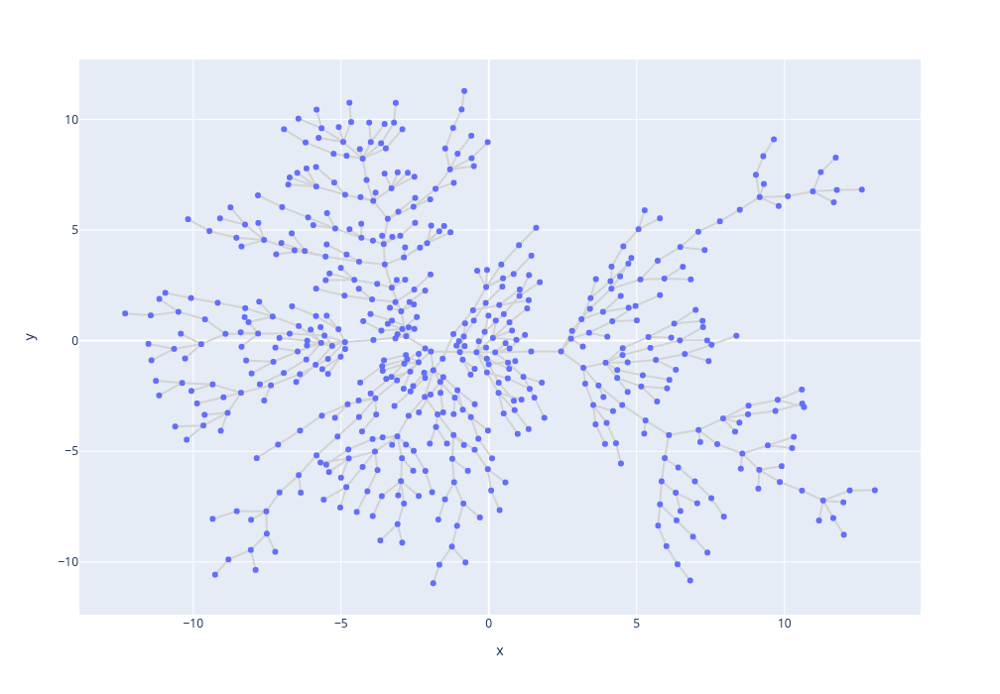

In [70]:

from scipy.sparse.csgraph import minimum_spanning_tree
from scipy.sparse import coo_matrix
import numpy as np
import igraph
import pandas as pd
import plotly.express as px

costs_df = pd.read_csv(
    f"results/vega-lite/vega-lite/difflib_costs.csv",
    names=["gallery", "system", "from_spec", "to_spec", "cost"])

square = costs_df.pivot_table(index="from_spec", columns="to_spec", values="cost").fillna(0)
order = list(square.index)

spanning = coo_matrix(minimum_spanning_tree(square))


g = igraph.Graph.Weighted_Adjacency(spanning.toarray().tolist())

layout= g.layout_kamada_kawai(maxiter=10000)
coords = np.array(layout.coords).T


fig = px.scatter(x=coords[0], y=coords[1], hover_name=order, height=700, width=700)
x = []
y = []
for i,j in zip(spanning.row, spanning.col):
    x += [coords[0][i], coords[0][j], None]
    y += [coords[1][i], coords[1][j], None]
fig.add_scatter(x=x,y=y, showlegend=False, line_color="lightgrey", line_width=2)
fig.data = tuple(reversed(fig.data))
fig

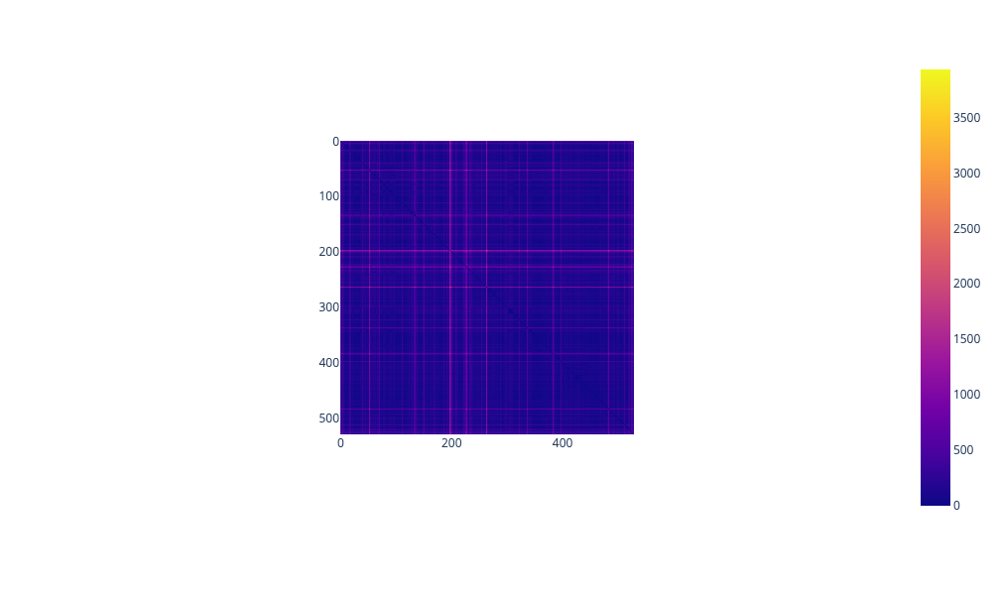

In [13]:
import plotly.express as px

px.imshow(square.values, height=600)

In [11]:
square.values.max()

3933.0

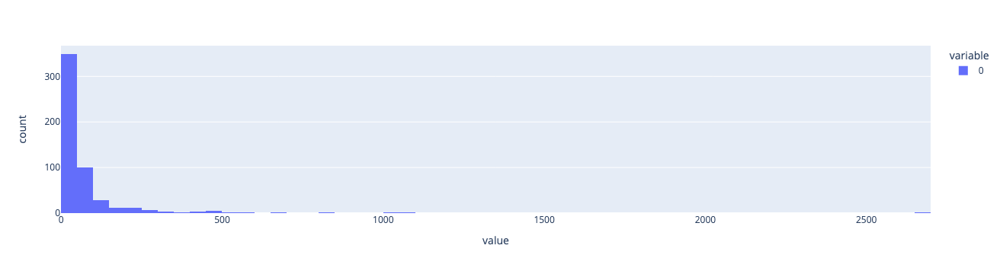

In [19]:
px.histogram(spanning.toarray()[np.where(spanning.toarray())])

In [31]:
import json

In [37]:
spanning = coo_matrix(minimum_spanning_tree(square))

cola = dict(nodes=[], links=[])
for i,j,d in zip(spanning.row, spanning.col, spanning.data):
    cola["links"].append(dict(source=order[i], target=order[j], length=d))
for n in order:
    cola["nodes"].append(dict(id=n))
json.dump(cola, open("./cola.json", "w"))


In [34]:
pwd

'/Users/nicolas/ets/notascope'